In [1]:
%matplotlib inline

In [2]:
import numpy as np
from scipy.fftpack import fft,ifft
from schrodinger import Schrodinger
import matplotlib.pyplot as plt
import sympy as sp
from scipy.integrate import odeint
from scipy.misc import derivative

from matplotlib import animation, rc
from IPython.display import HTML
rc('animation', html='jshtml')
import seaborn as sns

#Define plotting style:
sns.set() #Set style
sns.set_style('ticks',{'font.family':'serif', 'font.serif':'Times New Roman'})
sns.set_context('poster', font_scale=0.7,  rc={"lines.linewidth": 5})

## Auxiliary Functions

In [3]:
#Potential energy
xx,yy,zz = sp.symbols('x,y,z')
def V(x,y,z,k):    
    return -k/sp.sqrt(x**2+y**2+z**2)

#Force
def F(x,y,z,k):
    #Compute analytical derivative:
    Fx = -V(xx,yy,zz,k).diff(xx)
    Fy = -V(xx,yy,zz,k).diff(yy)
    Fz = -V(xx,yy,zz,k).diff(zz)
    
    #Replace result by numerical values:
    Fx = Fx.subs(xx,x).subs(yy,y).subs(zz,z)
    Fy = Fy.subs(xx,x).subs(yy,y).subs(zz,z)
    Fz = Fz.subs(xx,x).subs(yy,y).subs(zz,z)
    
    return [Fx,Fy,Fz]

In [4]:
#Differential equations:
def dsdt(s,t,m,k):
    x = s[0]
    y = s[1]
    z = s[2]
    vx = s[3]
    vy = s[4]
    vz = s[5]
    dxdt = vx
    dydt = vy
    dzdt = vz
            
    a = np.array(F(x,y,z,k))/m
    
    d = [vx,vy,vz] + a.tolist()
    
    return d

### Initial conditions (in terms of the orientation given by the angular momentum)
def getInitial(Lv,E,m,k):
    Eabs = np.abs(E)
    rmax = (m*k + np.sqrt(-2*m*Eabs*L**2 + k**2*m**2))/(2*Eabs*m)
    rhat = np.cross(np.array([0,1,0]),Lv) #gives the arbirtray orientation of the orbit in the plane
    rhat = rhat/np.linalg.norm(rhat)
    r0 = rmax*rhat
    v0 = np.cross(Lv,r0)/(m*rmax**2)
    y0 = r0.tolist()+v0.tolist()
    return y0

## Results

### Parameters:

In [5]:
#Parameters
Lv = np.array([0.5,0.0,1.0]) #Angular momentum
L = np.linalg.norm(Lv)
m = 0.1 #Mass
k = 1 #potential constant
Emin = -m*k**2/(2*L**2)
E = 0.8*Emin #energy
Eabs = np.abs(E)
T = np.pi*k*np.sqrt(m/2)/Eabs**(3/2) #Period

In [6]:
### Solve differential equations for trajectory:
#Get initial conditions:
y0 = getInitial(Lv,E,m,k)
tvals = np.linspace(0,T,1000)
ysol = odeint(dsdt, y0, tvals, args=(m,k))

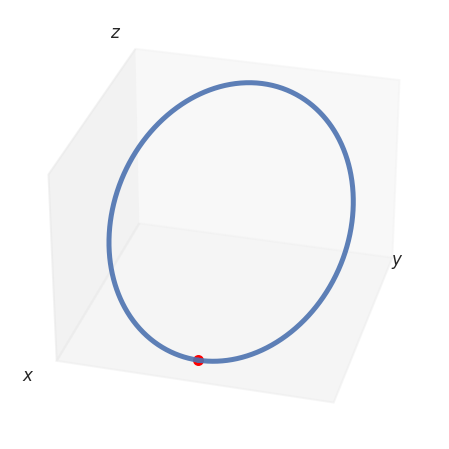

In [7]:
fig = plt.figure(figsize=(10,8))
ax = fig.add_subplot(projection='3d')

x = ysol[:,0]
y = ysol[:,1]
z = ysol[:,2]
vx = ysol[:,3]
vy = ysol[:,4]
vz = ysol[:,5]

ax.plot(x,y,z,alpha=0.9)
ax.scatter(x[:1],y[:1],z[:1],s=80,c='red')

# ax.scatter([0],[0],[0],s=80,c='green')
# rVec = ax.quiver(0,0,0,x[0],y[0],z[0],color='r',linewidth=2)
# vVec = ax.quiver(x[0],y[0],z[0],vx[0],vy[0],vz[0],color='g',linewidth=2,length=5)    
# LVec = ax.quiver(0,0,0,Lv[0],Lv[1],Lv[2],color='orange',linewidth=2,length=5)    


ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$y$')
ax.set_zlabel(r'$z$')
ax.view_init(elev=30., azim=15)
ax.grid(False)
ax.set_xticks([])
ax.set_yticks([])
ax.set_zticks([])
ax.xaxis._axinfo['juggled'] = (0,0,0)
ax.yaxis._axinfo['juggled'] = (1,1,1)
ax.zaxis._axinfo['juggled'] = (2,2,2)
plt.savefig('ellipticOrbit.png')
plt.show()

## 3D animation for trajectory

In [8]:
#Parameters
Lv = np.array([0.5,0.0,1.0]) #Angular momentum
L = np.linalg.norm(Lv)
m = 0.1 #Mass
k = 1 #potential constant
Emin = -m*k**2/(2*L**2)
E = 0.7*Emin #energy
Eabs = np.abs(E)
T = np.pi*k*np.sqrt(m/2)/Eabs**(3/2) #Period

### Solve differential equations for trajectory:
y0 = getInitial(Lv,E,m,k)
tvals = np.linspace(0,2*T,2000)
ysol = odeint(dsdt, y0, tvals, args=(m,k))

In [9]:
# Set up plot
fig = plt.figure(figsize=(10,8))
ax = fig.add_subplot(projection='3d')

point = ax.scatter(ysol[:1,0],ysol[:1,1],ysol[:1,2],'o',s=80,c='red')
line, = ax.plot(ysol[:,0],ysol[:,1],ysol[:,2],'-',alpha=0.5)
# LVec = ax.quiver(0,0,0,Lv[0],Lv[1],Lv[2],color='orange',linewidth=2,length=5)    


ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$y$')
ax.set_zlabel(r'$z$')
ax.view_init(elev=30., azim=15)
ax.grid(False)
ax.set_xticks([])
ax.set_yticks([])
ax.set_zticks([])
ax.xaxis._axinfo['juggled'] = (0,0,0)
ax.yaxis._axinfo['juggled'] = (1,1,1)
ax.zaxis._axinfo['juggled'] = (2,2,2)
title = plt.title('$t = 0$')

# Animate plot
def init():
    point._offsets3d = ([], [], [])
    line.set_data(ysol[:1,0], ysol[:1,1])
    line.set_3d_properties(ysol[:1,2])
    

    title.set_text("")
    return (point, line, title)

def animate(i):    
    
    t = tvals[i]
    point._offsets3d = (ysol[i-1:i,0], ysol[i-1:i,1], ysol[i-1:i,2])
    line.set_data(ysol[:i,0], ysol[:i,1])
    line.set_3d_properties(ysol[:i,2])

    title.set_text("t = %.2f" % t)
        
    return (point, line, title)

# call the animator.  blit=True means only re-draw the parts that have changed.
frames = len(tvals)
aspeed = 10.0

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=frames, interval=100/aspeed, blit=True)

#Para salvar corretamente, tem que descomentar a linha de baixo
anim.save('ellipticOrbit3D.mp4', fps=40, extra_args=['-vcodec', 'libx264'])

#Para ver o video no notebook deve comentar a linha de cima
plt.close()
anim


Animation size has reached 20998767 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
